In [1]:
import os
import re
import matplotlib.pylab as plt
from labellines import labelLine, labelLines
import seaborn as sns
import numpy as np
import pandas as pd


Load the files. 

In [2]:
directory = '../flip/flamespeeds'

list_of_csvs = [file for file in os.listdir(directory) if re.search('flamespeed_[0-9]+\.csv',file)]

#len(list_of_csvs)

#place in a dictionary, where key is model size, and value is file name for that model 
csv_dict = {}
for file in list_of_csvs:
    match = re.search('flamespeed_([0-9]+)\.csv',file)
    csv_dict[int(match.group(1))] = file
    
#sort them by number
sd = sorted(csv_dict.items())

#make into a sorted dictionary
sorted_csv_dict = {}
for k,v in sd:
    sorted_csv_dict[k] = v
    


Create a dataframe. 

In [3]:
#make the empty dataframe

#these will be columms of the dataframe 
fractions = [0.0,0.0034246488829682868,0.006825921381900819,0.01020405603073009,0.01355928812903828,0.016891849796691408,0.02020197002736977,0.023489874741020596,0.02675578683525816,0.029999926235735837]
columns = ['{:.4f}'.format(100*x) for x in fractions]
columns.append('model')
df = pd.DataFrame(columns = columns)



#make lists from csv files
for k,v in sorted_csv_dict.items(): 
    
    #make a dictionary to hold this info
    dict_for_df = {}
    
    #get the info going into the dictionary
    with open(f'../flip/flamespeeds/{v}','r') as f: 
        lines = f.readlines()
        
        #format the fractions
        newline = lines[0].replace('[','').replace(']','').replace('\n','')
        fracs = [float(x) for x in newline.split(', ')]
        rounded_fracs = ['{:.4f}'.format(100*x) for x in fracs]
        
        #format the speeds 
        newline = lines[-1].replace('[','').replace(']','').replace('\n','')
        speeds = [float(x) for x in newline.split(', ')]
    
    #put into the dictionary
    for rounded_frc, spd in zip(rounded_fracs,speeds):
        dict_for_df[rounded_frc]=spd
    dict_for_df['model'] = k
    
    
    #what if there's missing values?
    nonmatches = [i for i in columns if i not in dict_for_df.keys()]
    for i in nonmatches: 
         dict_for_df[i] = '--------'
        
    #put it in dataframe   
    df_to_be_appended=pd.DataFrame([dict_for_df])
    df = pd.concat([df, df_to_be_appended],ignore_index=True)
    
pd.set_option("display.max_rows", None)
df



,0.0000,0.3425,0.6826,1.0204,1.3559,1.6892,2.0202,2.3490,2.6756,3.0000,model
0,0.371365,0.320751,0.281871,0.237485,0.186778,0.139392,0.104222,0.082532,0.068527,0.057988,1
1,0.371365,0.320751,0.281871,0.237485,0.186778,0.139392,0.104222,0.082532,0.068527,0.057988,2
2,0.371365,0.320751,0.281871,0.237485,0.186778,0.139392,0.104222,0.082532,0.068527,0.057988,3
3,0.371365,0.320751,0.281871,0.237485,0.186778,0.139392,0.104222,0.082532,0.068527,0.057988,4
4,0.371365,0.320751,0.281871,0.237485,0.186778,0.139392,0.104222,0.082532,0.068527,0.057988,5
5,0.371365,0.320751,0.281871,0.237485,0.186778,0.139392,0.104222,0.082532,0.068527,0.057988,6
6,0.371365,0.320751,0.281871,0.237485,0.186778,0.139392,0.104222,0.082532,0.068527,0.057988,7
7,0.371365,0.320751,0.281871,0.237485,0.186778,0.139392,0.104222,0.082532,0.068527,0.057988,8
8,0.371365,0.320751,0.281871,0.237485,0.186778,0.139392,0.104222,0.082532,0.068527,0.057988,9
9,0.371365,0.320751,0.281871,0.237485,0.186778,0.139392,0.104222,0.082532,0.068527,0.057988,10


Plot each mechanism. 

In [4]:
############ color stuff (https://medium.com/@BrendanArtley/matplotlib-color-gradients-21374910584b) ###############

def hex_to_RGB(hex_str):
    """ #FFFFFF -> [255,255,255]"""
    #Pass 16 to the integer function for change of base
    return [int(hex_str[i:i+2], 16) for i in range(1,6,2)]

def get_color_gradient(c1, c2, n):
    """
    Given two hex colors, returns a color gradient
    with n colors.
    """
    assert n > 1
    c1_rgb = np.array(hex_to_RGB(c1))/255
    c2_rgb = np.array(hex_to_RGB(c2))/255
    mix_pcts = [x/(n-1) for x in range(n)]
    rgb_colors = [((1-mix)*c1_rgb + (mix*c2_rgb)) for mix in mix_pcts]
    return ["#" + "".join([format(int(round(val*255)), "02x") for val in item]) for item in rgb_colors]

#color1 = "#8A5AC2"
color2 = "#3575D5"

color1 = '#FB575D'
#color2 = '#15251B'

# a = [120,121,122,123,124,125,126]

# get_color_gradient(color1, color2, len(a))

<ipython-input-5-1e51982b2d70>:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax2 = fig2.add_subplot(111)
<ipython-input-5-1e51982b2d70>:44: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax1 = fig.add_subplot(111)


added in 1
added in 10
added in 100
added in 1000
added in 101
added in 102
added in 103
added in 104
added in 105
added in 106
added in 107
added in 108
added in 109
added in 11
added in 110
added in 111
added in 112
added in 113
added in 114


<ipython-input-5-1e51982b2d70>:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig2 = plt.figure()


added in 115
added in 116
added in 117
added in 118
added in 119
added in 12
added in 120
added in 121
added in 122
added in 123
added in 124
added in 125
added in 126
added in 127
added in 128
added in 129
added in 13
added in 130
added in 131
added in 132
added in 133
added in 134
added in 135
added in 136
added in 137
added in 138
added in 139
added in 14
added in 140
added in 141
added in 142
added in 143
added in 144
added in 145
added in 146
added in 147
added in 148
added in 149
added in 15
added in 150
added in 151
added in 152
added in 153
added in 154
added in 155
added in 156
added in 157
added in 158
added in 159
added in 16
added in 160
added in 161
added in 162
added in 163
added in 164
added in 165
added in 166
added in 167
added in 168
added in 169
added in 17
added in 170
added in 171
added in 172
added in 173
added in 174
added in 175
added in 176
added in 177
added in 178
added in 179
added in 18
added in 180
added in 181
added in 182
added in 183
added in 184
added 

<ipython-input-5-1e51982b2d70>:58: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax1 = fig.add_subplot(111)


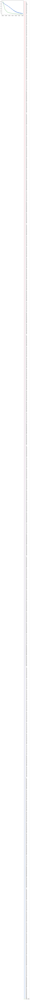

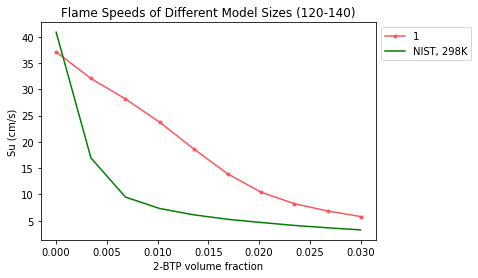

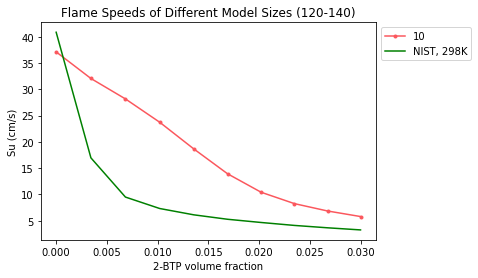

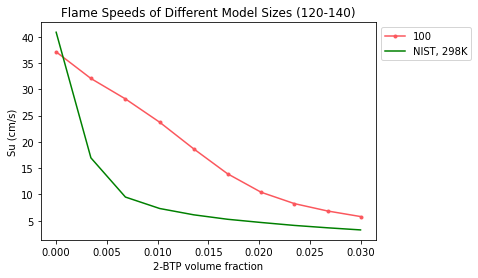

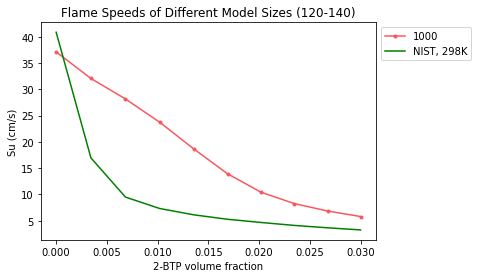

...

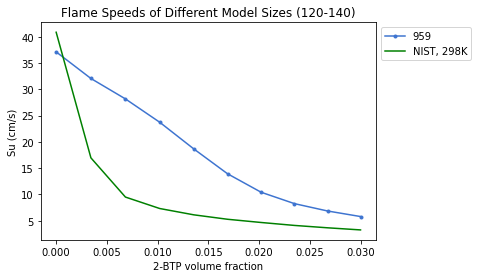

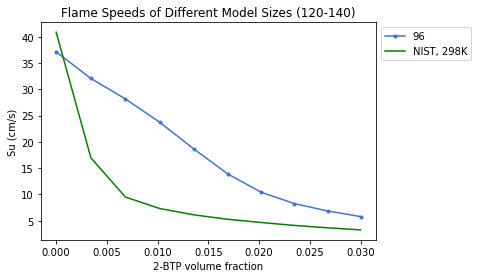

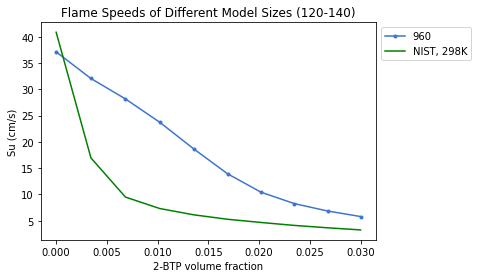

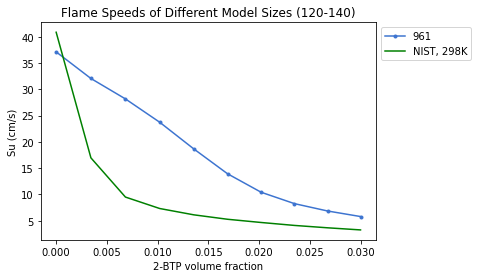

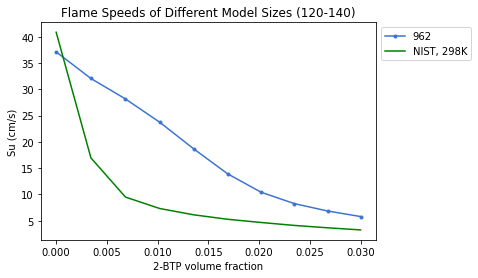

In [ ]:

directory = '../flip/flamespeeds'

list_of_blends = [file for file in os.listdir(directory) if re.search('flamespeed_([0-9]+)\.csv', file)]
colors = get_color_gradient(color1, color2, len(list_of_blends ))

fig = plt.figure()


#add in NIST model

volfrac_of_btp = [0.0,0.0034246488829682868,0.006825921381900819,0.01020405603073009,0.01355928812903828,0.016891849796691408,0.02020197002736977,0.023489874741020596,0.02675578683525816,0.029999926235735837]
# fracs = [x*100 for x in volfrac_of_btp]
flamespeeds = [0.40875258644125273,0.16966926524557838,0.09506093355318838,0.07327356686247803,0.061265194613989125,0.052793644460558425,0.04667136814266926,0.04106928680179994,0.0365547487209216,0.03252991701877541]
speeds = [x*100 for x in flamespeeds]

#add in NIST model

volfrac_of_btp = [0.0,0.0034246488829682868,0.006825921381900819,0.01020405603073009,0.01355928812903828,0.016891849796691408,0.02020197002736977,0.023489874741020596,0.02675578683525816,0.029999926235735837]
# fracs = [x*100 for x in volfrac_of_btp]
flamespeeds = [0.40875258644125273,0.16966926524557838,0.09506093355318838,0.07327356686247803,0.061265194613989125,0.052793644460558425,0.04667136814266926,0.04106928680179994,0.0365547487209216,0.03252991701877541]
speeds_ = [x*100 for x in flamespeeds]




for color, file in zip(colors, list_of_blends): 
    
        fig2 = plt.figure()
        match = re.search('flamespeed_([0-9]+)\.csv', file)
    

        with open(f'../flip/flamespeeds/{file}', 'r') as f: 
            values = f.readlines()
            frcs = values[0].replace('[','').replace(']','')
            spds = values[1].replace('[','').replace(']','')
        BTP_fractions = [float(x) for x in frcs.split(',')]
       # print(values[1].split(','))
        speed = [float(x) for x in spds.split(',')]
        speeds = [x*100 for x in speed]
        

        #plotting 
        
        ax1 = fig.add_subplot(111)
        ax1.plot(BTP_fractions, speeds, '.-', c=f'{color}', label=str(match.group(1)))

        plt.xlabel('2-BTP volume fraction')
        plt.ylabel('Su (cm/s)')
        plt.title('Flame Speeds of Different Model Sizes (120-140)')
        ax1.legend(bbox_to_anchor=(0.5, 0., 0.8, 1))
        
        ax2 = fig2.add_subplot(111)
        ax2.plot(BTP_fractions, speeds, '.-', c=f'{color}', label=str(match.group(1)))
        ax2.plot(volfrac_of_btp, speeds_, '-', c='g', label='NIST, 298K' )
        ax2.legend(bbox_to_anchor=(0.5, 0., 0.8, 1))
        print(f'added in {match.group(1)}')
        
ax1 = fig.add_subplot(111)

ax1.plot(volfrac_of_btp, speeds_, '-', c='g', label='NIST, 298K' )


plt.xlabel('2-BTP volume fraction')
plt.ylabel('Su (cm/s)')
plt.title('Flame Speeds of Different Model Sizes (120-140)')
ax1.legend(bbox_to_anchor=(0.5, 0., 0.8, 1))
        
  

        
        